In [1]:
import face_recognition as fr
from PIL import Image
from os import listdir
import matplotlib.pyplot as plt
import glob
import numpy as np


In [2]:
path = "data/CK+/"
data  = listdir(path)
ignore = ["morralla",".DS_Store"]
imgs = []
state = []

In [3]:
for item in data:
    if item not in ignore:
        imgs.extend([f"{path}{item}/{p}" for p in listdir(f"{path}{item}")])
        state.extend([item for p in listdir(f"{path}{item}")])

In [4]:
state

['surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',
 'surprise',

In [5]:
imgs = [np.array(Image.open(p)) for p in imgs]

In [6]:
imgs[0].shape

(490, 640)

In [7]:
len(imgs)

920

In [8]:
features = [fr.face_landmarks(im) for im in imgs]

In [9]:
len(features)

920

In [10]:
landmarks = []
for feat in features:
    land = {}
    for name, values in feat[0].items():
        land[name] =  np.array(values)[:,0], np.array(values)[:,1]
    landmarks.append(land)

In [11]:
len(landmarks)

920

In [21]:
# def fig2data ( fig ):
#     """
#     @brief Convert a Matplotlib figure to a 4D numpy array with RGBA channels and return it
#     @param fig a matplotlib figure
#     @return a numpy 3D array of RGBA values
#     """
#     # draw the renderer
#     fig.canvas.draw ( )
 
#     # Get the RGBA buffer from the figure
#     w,h = fig.canvas.get_width_height()
#     buf = np.frombuffer ( fig.canvas.tostring_argb(), dtype=np.uint8 )
#     buf.shape = ( w, h,4 )
 
#     # canvas.tostring_argb give pixmap in ARGB mode. Roll the ALPHA channel to have it in RGBA mode
#     buf = np.roll ( buf, 3, axis = 2 )
#     return buf

In [22]:
# def fig2img ( fig ):
#     """
#     @brief Convert a Matplotlib figure to a PIL Image in RGBA format and return it
#     @param fig a matplotlib figure
#     @return a Python Imaging Library ( PIL ) image
#     """
#     # put the figure pixmap into a numpy array
#     buf = fig2data ( fig )
#     w, h, d = buf.shape
#     return Image.frombytes( "RGBA", ( w ,h ), buf.tostring( ) )

<ipython-input-23-3fa8e157e708>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = plt.figure(figsize=(10,10))


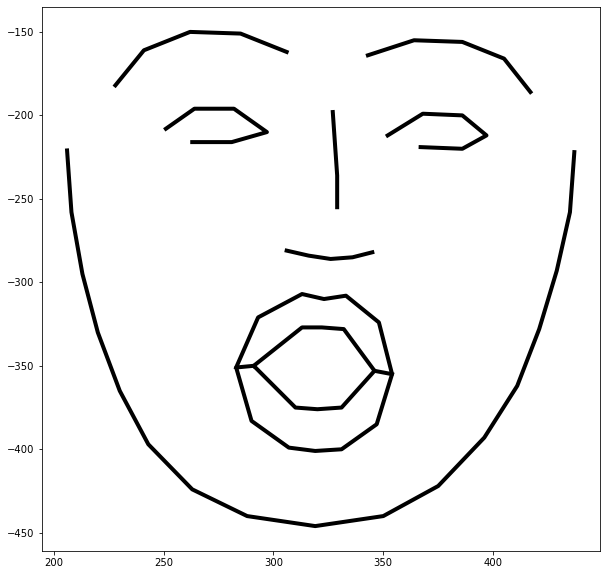

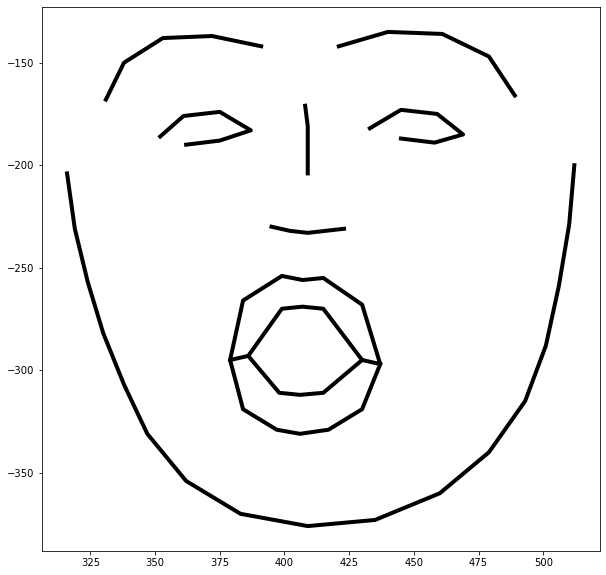

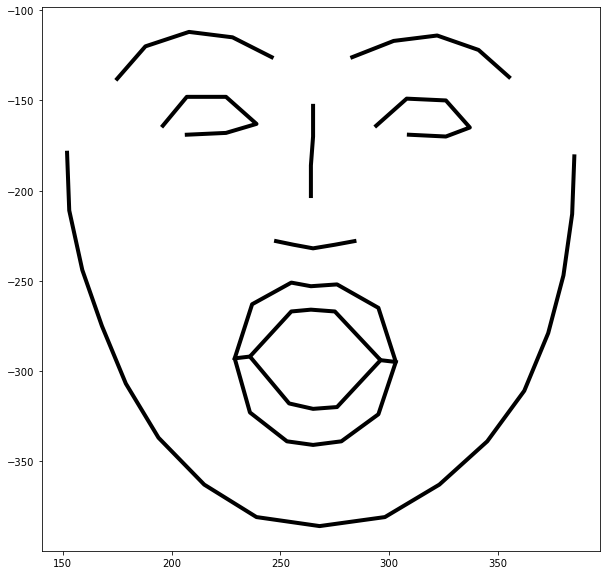

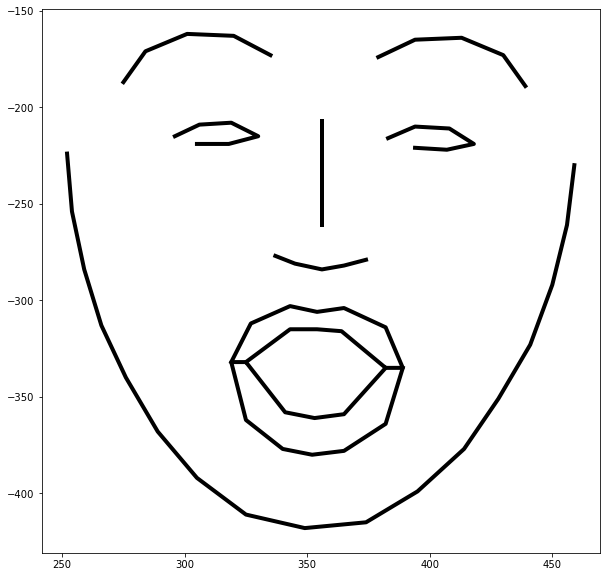

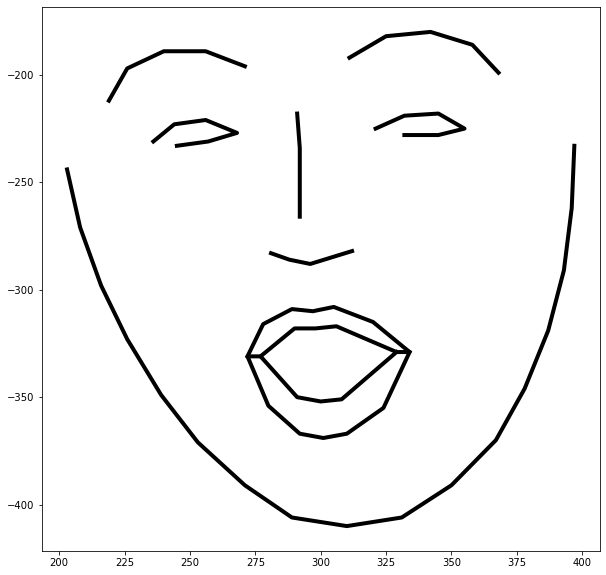

...

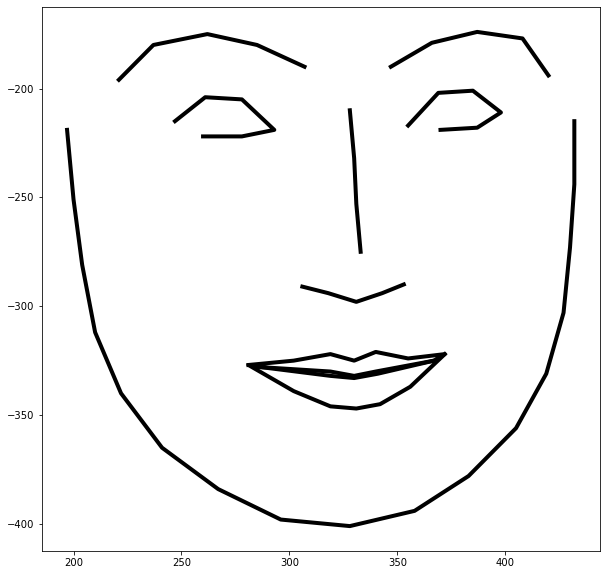

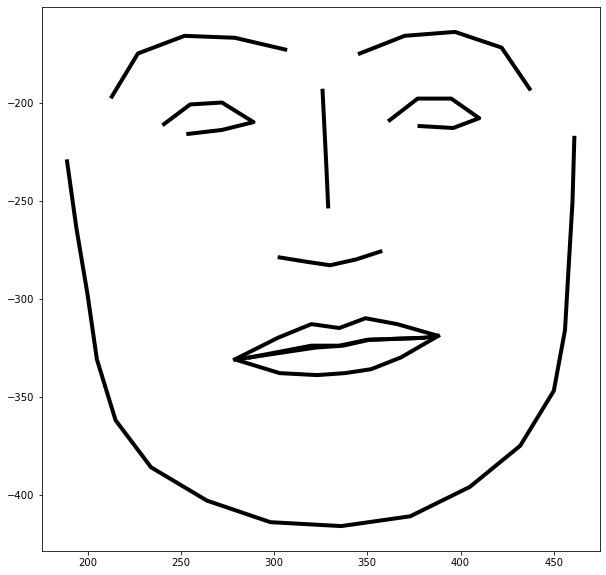

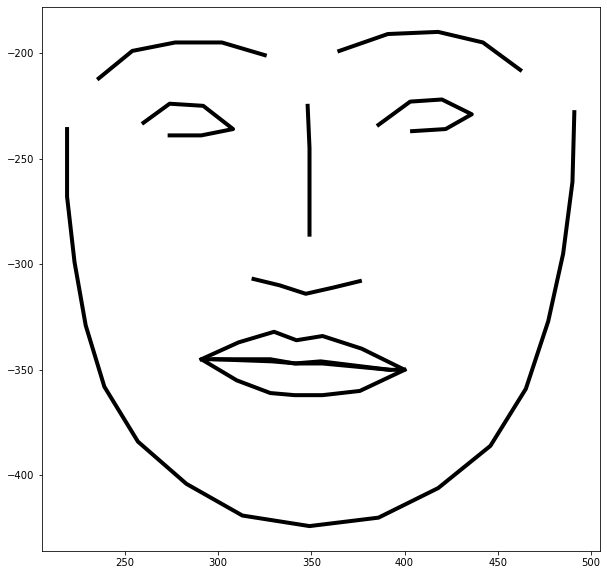

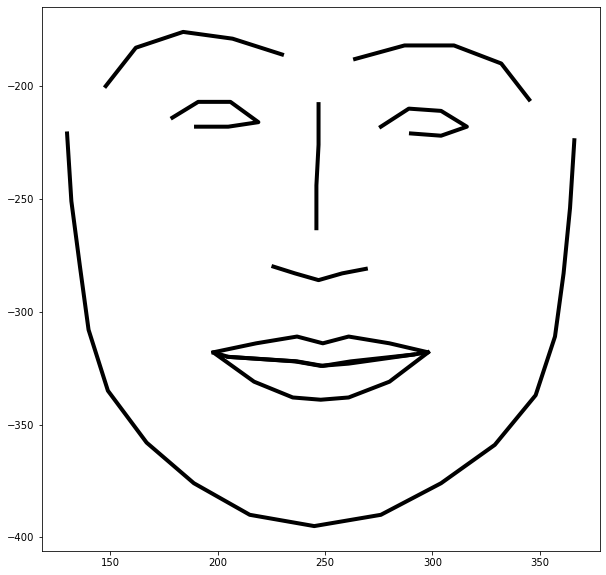

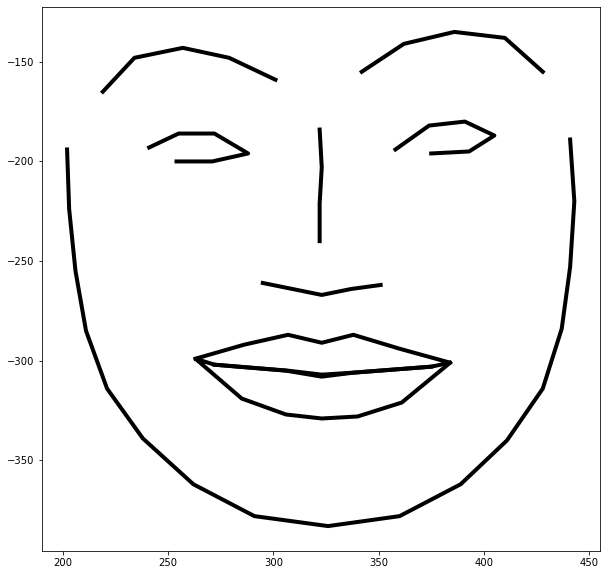

In [23]:
# land_imgs= []
# for i in range(len(landmarks)):
#     figure = plt.figure(figsize=(10,10))
#     for name, (x,y)in landmarks[i].items():
#         plot = plt.plot(x,-y, linewidth = 4, c="k")
#     land_imgs.append(fig2data(figure))

In [ ]:
# im = fig2data ( figure )
# len(im)

In [14]:
land_imgs= []
plt.ioff()
for i in range(len(landmarks)):
    figure = plt.figure(figsize=(10,10))
    plt.axis("off")
    for name, (x,y)in landmarks[i].items():
        plot = plt.plot(x,-y, linewidth = 4, c="k")
    plt.savefig(f"data/matplotfaces/{state[i]}_{i}.png") 
    plt.close(figure)

In [24]:
len(land_imgs)

920

In [25]:
land_imgs[0].shape


(720, 720, 4)

In [26]:
data_imgs = np.array(land_imgs)

In [28]:
data_imgs = data_imgs/255

In [30]:
data_imgs.shape

(920, 720, 720, 4)

In [33]:
data_imgs_r = np.reshape(data_imgs,(920,720,720))

ValueError: cannot reshape array of size 1907712000 into shape (920,720,720)